In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
sns.set_theme ()

import matplotlib.pyplot as plt
%matplotlib inline

from IPython.display import Audio, display
from scipy.io.wavfile import write

import glob
import librosa
import librosa.display
import swifter

# loading of the necessary packages/libraries for this first part

In [2]:
VIZ = pd.read_excel ('dsd100.xlsx')

# use of the aforementionned dsd100 excel file

VIZ.info()
VIZ.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Name      100 non-null    object
 1   Style     100 non-null    object
 2   Duration  100 non-null    object
dtypes: object(3)
memory usage: 2.5+ KB


,Name,Style,Duration
0,Actions - Devil's Words,Power Pop,3'17''
1,Actions - One Minute Smile,Power Pop,2'44''
2,Actions - South Of The Water,Power Pop,3'11''
3,Al James - Schoolboy Facination,Bubblegum Pop,3'21''
4,AM Contra - Heart Peripheral,Electronic Dance Pop,3'30''


In [3]:
overall_list = glob.glob('/Users/francoistouchard/Music/DSD100/*')

Titles = sorted (list(x.split('/')[5] for x in overall_list))
Titles [:13]

['001 - ANiMAL - Clinic A',
 '002 - ANiMAL - Rockshow',
 '003 - Actions - One Minute Smile',
 '004 - Al James - Schoolboy Facination',
 '005 - Angela Thomas Wade - Milk Cow Blues',
 '006 - Atlantis Bound - It Was My Fault For Waiting',
 '007 - BKS - Too Much',
 '008 - Bill Chudziak - Children Of No-one',
 '009 - Bobby Nobody - Stitch Up',
 '010 - Carlos Gonzalez - A Place For Us',
 '011 - Cnoc An Tursa - Bannockburn',
 '012 - Dark Ride - Burning Bridges',
 '013 - Drumtracks - Ghost Bitch']

In [4]:
AUDIO = pd.DataFrame(Titles, columns = ['Name'])

AUDIO .info()
AUDIO .head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Name    100 non-null    object
dtypes: object(1)
memory usage: 928.0+ bytes


,Name
0,001 - ANiMAL - Clinic A
1,002 - ANiMAL - Rockshow
2,003 - Actions - One Minute Smile
3,004 - Al James - Schoolboy Facination
4,005 - Angela Thomas Wade - Milk Cow Blues


In [5]:
for channel in ['mixture', 'vocals', 'drums', 'bass', 'other']:    
    
    AUDIO [channel] = glob.glob('/Users/francoistouchard/Music/DSD100/*/' + channel + '.wav')
    
AUDIO 

,Name,mixture,vocals,drums,bass,other
0,001 - ANiMAL - Clinic A,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...
1,002 - ANiMAL - Rockshow,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...
2,003 - Actions - One Minute Smile,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...
3,004 - Al James - Schoolboy Facination,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...
4,005 - Angela Thomas Wade - Milk Cow Blues,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...
...,...,...,...,...,...,...
95,096 - Triviul - Angelsaint,/Users/francoistouchard/Music/DSD100/015 - Fer...,/Users/francoistouchard/Music/DSD100/015 - Fer...,/Users/francoistouchard/Music/DSD100/015 - Fer...,/Users/francoistouchard/Music/DSD100/015 - Fer...,/Users/francoistouchard/Music/DSD100/015 - Fer...
96,097 - Triviul feat. The Fiend - Widow,/Users/francoistouchard/Music/DSD100/066 - Fla...,/Users/francoistouchard/Music/DSD100/066 - Fla...,/Users/francoistouchard/Music/DSD100/066 - Fla...,/Users/francoistouchard/Music/DSD100/066 - Fla...,/Users/francoistouchard/Music/DSD100/066 - Fla...
97,098 - Wall Of Death - Femme,/Users/francoistouchard/Music/DSD100/078 - Moo...,/Users/francoistouchard/Music/DSD100/078 - Moo...,/Users/francoistouchard/Music/DSD100/078 - Moo...,/Users/francoistouchard/Music/DSD100/078 - Moo...,/Users/francoistouchard/Music/DSD100/078 - Moo...
98,099 - Young Griffo - Blood To Bone,/Users/francoistouchard/Music/DSD100/048 - We ...,/Users/francoistouchard/Music/DSD100/048 - We ...,/Users/francoistouchard/Music/DSD100/048 - We ...,/Users/francoistouchard/Music/DSD100/048 - We ...,/Users/francoistouchard/Music/DSD100/048 - We ...


In [6]:
AUDIO['Index'] = AUDIO.Name.apply (lambda x: x[:3]).astype (int)

AUDIO['Name'] = AUDIO.Name.apply (lambda x: x[6:])

AUDIO = AUDIO.rename({'mixture':'mix'},axis=1)

AUDIO.head()

,Name,mix,vocals,drums,bass,other,Index
0,ANiMAL - Clinic A,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,1
1,ANiMAL - Rockshow,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,2
2,Actions - One Minute Smile,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,3
3,Al James - Schoolboy Facination,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,4
4,Angela Thomas Wade - Milk Cow Blues,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,5


In [7]:
AUDIO = AUDIO.merge(VIZ, on = 'Name', how = 'left').drop('Duration', 1)

AUDIO.head()

,Name,mix,vocals,drums,bass,other,Index,Style
0,ANiMAL - Clinic A,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,1,UK Hip-Hop
1,ANiMAL - Rockshow,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,2,UK Hip-Hop
2,Actions - One Minute Smile,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,3,Power Pop
3,Al James - Schoolboy Facination,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,4,Bubblegum Pop
4,Angela Thomas Wade - Milk Cow Blues,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,5,Country


In [8]:
AUDIO = AUDIO.set_index ('Index')

AUDIO.head()

,Name,mix,vocals,drums,bass,other,Style
Index,,,,,,,
1,ANiMAL - Clinic A,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,UK Hip-Hop
2,ANiMAL - Rockshow,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,UK Hip-Hop
3,Actions - One Minute Smile,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,Power Pop
4,Al James - Schoolboy Facination,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,Bubblegum Pop
5,Angela Thomas Wade - Milk Cow Blues,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,Country


In [9]:
column_titles = ['Name', 'Style', 'mix', 'vocals','drums', 'bass', 'other']

AUDIO = AUDIO.reindex(columns = column_titles)

AUDIO.info()
AUDIO.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100 entries, 1 to 100
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Name    100 non-null    object
 1   Style   99 non-null     object
 2   mix     100 non-null    object
 3   vocals  100 non-null    object
 4   drums   100 non-null    object
 5   bass    100 non-null    object
 6   other   100 non-null    object
dtypes: object(7)
memory usage: 6.2+ KB


,Name,Style,mix,vocals,drums,bass,other
Index,,,,,,,
1,ANiMAL - Clinic A,UK Hip-Hop,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...,/Users/francoistouchard/Music/DSD100/040 - The...
2,ANiMAL - Rockshow,UK Hip-Hop,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...,/Users/francoistouchard/Music/DSD100/071 - Jam...
3,Actions - One Minute Smile,Power Pop,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...,/Users/francoistouchard/Music/DSD100/035 - Sig...
4,Al James - Schoolboy Facination,Bubblegum Pop,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...,/Users/francoistouchard/Music/DSD100/057 - BKS...
5,Angela Thomas Wade - Milk Cow Blues,Country,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...,/Users/francoistouchard/Music/DSD100/001 - ANi...


In [10]:
AUDIO.to_csv ('dsd100_paths.csv')

# LISTENING

In [11]:
def AUDIO_loading (index, source):
    
    signal, __ = librosa.load (AUDIO.loc[index, source], sr = None)
    
    return signal

In [12]:
def AUdio (track, channel, random = True):
    
    if random :
        channel = np.random.choice (['mix', 'vocals', 'drums', 'bass', 'other'])
        track = np.random.choice(np.arange(1,101))
        
    else:
        channel = channel
        track = track

    y = AUDIO_loading (track, channel)

    print ('track n° {}, channel: {}'.format(track, channel))
    print()
    
    return Audio (y, rate = 44100)

In [13]:
# track is between 1 and 100, channel chosen among ['mix', 'vocals', 'drums', 'bass', 'other']

AUdio (999999991, 'anyone')

track n° 3, channel: vocals



In [14]:
data = AUDIO.copy()

for channel in ['mix', 'vocals', 'drums', 'bass', 'other']:  
    
    data[channel] = data[channel].swifter.apply (lambda x: librosa.load (x, sr = None)[0])
    
data.head()

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

,Name,Style,mix,vocals,drums,bass,other
Index,,,,,,,
1,ANiMAL - Clinic A,UK Hip-Hop,"[-0.0020141602, -0.0017700195, -0.0011749268, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.001083374, -0.00076293945, -0.00047302246,...","[-0.00079345703, -0.0008544922, -0.0005493164,...","[-0.00010681152, -0.00010681152, -0.0001373291..."
2,ANiMAL - Rockshow,UK Hip-Hop,"[7.6293945e-05, 6.1035156e-05, 9.1552734e-05, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 4.5776367e-05, 0.0, 1.5258789e-05, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[9.1552734e-05, 0.0, 9.1552734e-05, 9.1552734e..."
3,Actions - One Minute Smile,Power Pop,"[-7.6293945e-05, 6.1035156e-05, 1.5258789e-05,...","[-1.5258789e-05, -4.5776367e-05, 0.00012207031...","[-6.1035156e-05, 6.1035156e-05, -3.0517578e-05...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.5258789e-05, 3.0517578e-05, -4.5776367e-05,..."
4,Al James - Schoolboy Facination,Bubblegum Pop,"[-0.0005493164, -0.00036621094, -0.000579834, ...","[3.0517578e-05, 3.0517578e-05, 3.0517578e-05, ...","[-0.0005340576, -0.00030517578, -0.00050354004...","[3.0517578e-05, 3.0517578e-05, 3.0517578e-05, ...","[-7.6293945e-05, -0.00012207031, -0.0001373291..."
5,Angela Thomas Wade - Milk Cow Blues,Country,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [15]:
data['music'] = data.drums + data.bass + data.other

data.head()

,Name,Style,mix,vocals,drums,bass,other,music
Index,,,,,,,,
1,ANiMAL - Clinic A,UK Hip-Hop,"[-0.0020141602, -0.0017700195, -0.0011749268, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.001083374, -0.00076293945, -0.00047302246,...","[-0.00079345703, -0.0008544922, -0.0005493164,...","[-0.00010681152, -0.00010681152, -0.0001373291...","[-0.0019836426, -0.0017242432, -0.001159668, -..."
2,ANiMAL - Rockshow,UK Hip-Hop,"[7.6293945e-05, 6.1035156e-05, 9.1552734e-05, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 4.5776367e-05, 0.0, 1.5258789e-05, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[9.1552734e-05, 0.0, 9.1552734e-05, 9.1552734e...","[9.1552734e-05, 4.5776367e-05, 9.1552734e-05, ..."
3,Actions - One Minute Smile,Power Pop,"[-7.6293945e-05, 6.1035156e-05, 1.5258789e-05,...","[-1.5258789e-05, -4.5776367e-05, 0.00012207031...","[-6.1035156e-05, 6.1035156e-05, -3.0517578e-05...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.5258789e-05, 3.0517578e-05, -4.5776367e-05,...","[-4.5776367e-05, 9.1552734e-05, -7.6293945e-05..."
4,Al James - Schoolboy Facination,Bubblegum Pop,"[-0.0005493164, -0.00036621094, -0.000579834, ...","[3.0517578e-05, 3.0517578e-05, 3.0517578e-05, ...","[-0.0005340576, -0.00030517578, -0.00050354004...","[3.0517578e-05, 3.0517578e-05, 3.0517578e-05, ...","[-7.6293945e-05, -0.00012207031, -0.0001373291...","[-0.000579834, -0.00039672852, -0.00061035156,..."
5,Angela Thomas Wade - Milk Cow Blues,Country,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [16]:
def save_parquet (original_data, file, save = False):

    if save  == True:
        
        original_data.to_parquet (file)

def load_parquet (file, load = False):
    
    if load == True:
        
        load = pd.read_parquet (file)
        
        return load

In [17]:
save_parquet (data, 'df_DSD100_44100Hz', False)

data = load_parquet ('df_DSD100_44100Hz', False)

data.head()

# AUDIO signal VIZ'

In [16]:
def plot_audio (track, colors = None, audios = None, labels = None, all_channels = True):
    
    mix =  AUDIO_loading (track, 'mix')
    vocals = AUDIO_loading (track, 'vocals')
    drums = AUDIO_loading (track, 'drums')
    bass = AUDIO_loading (track, 'bass')
    other = AUDIO_loading (track,'other')
    
    x = np.arange (len(mix))/44100
    
    T = len(mix)/44100
    x_ticks = np.arange(0, 30 * (int(T/30)+1) , 30)
    
    t = int (T/60)
    tick_labels =[]
    
    for i in range (t+1):
        for j in range(2):
            a = i
            b = j*30
            tick = str(a) +':' + str(b)
            tick_labels.append(tick)
            
    while len(tick_labels) != len(x_ticks):
        tick_labels.pop(-1)
    
    if all_channels == True:
        
        fig, ax = plt.subplots (figsize = (39,7))

        ax.plot (x, mix, color = 'blue')
        ax.plot (x, vocals, color = 'red')
        ax.plot (x, drums, color = 'black')
        ax.plot (x, bass, color = 'green')
        ax.plot (x, other, color = 'magenta')      
        ax.set_xlabel ('Time', fontsize = 23)
        ax.set_xticks (x_ticks, tick_labels, fontsize = 19)
        ax.set_ylabel ('Amplitude', fontsize = 23) 
        ax.set_yticks (np.arange(-1,1.2, 0.2), np.round(np.arange(-1,1.2, 0.2),1) ,fontsize = 19)
        ax.legend (['mix', 'vocals', 'drums', 'bass', 'other'], fontsize = 23, loc = 'upper right')
        ax.set_ylim (-1,1)
        ax.set_xlim (-1, np.max (x)+1)       
        
    else:
        n = len (audios)
        m = 0
    
        for z in range(n):
            m = np.max([m, len(audios[z])])
        
        x = (np.arange(m))/44100
    
        T = m / 44100
        x_ticks = np.arange(0, 30 * (int(T/30)+1) , 30)
    
        t = int (T/60)
        tick_labels =[]
    
        for i in range (t+1):
            for j in range(2):
                a = i
                b = j*30
                tick = str(a) +':' + str(b)
                tick_labels.append(tick)
            
        while len(tick_labels) != len(x_ticks):
            tick_labels.pop(-1)
    
        fig, ax = plt.subplots (figsize = (39,7))
        
        for z in range(n): 
            ax.plot ((np.arange(len(audios[z])))/44100, audios[z], c = colors [z])  
            
        ax.legend (labels, fontsize = 23, loc = 'upper right')
        ax.set_xlabel ('Time', fontsize = 23)
        ax.set_xticks (x_ticks, tick_labels, fontsize = 19)
        ax.set_ylabel ('Amplitude', fontsize = 23) 
        ax.set_yticks (np.arange(-1,1.2, 0.2), np.round(np.arange(-1,1.2, 0.2),1) ,fontsize = 19)
        ax.set_ylim (-1,1)
        ax.set_xlim (-1, np.max (x)+1) 
        plt.show();

track: 93



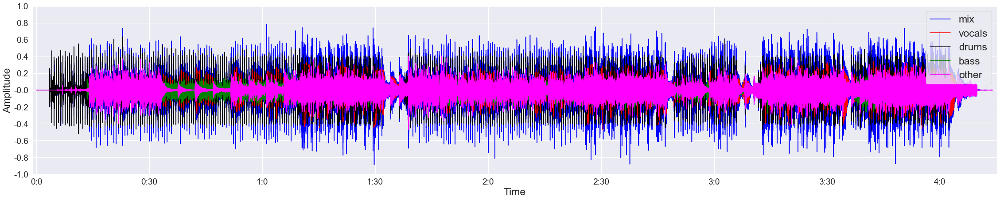

In [17]:
# overlay of all signals for a random value of index

track = np.random.choice(np.arange(1,101))

print ('track: {}'.format(track))
print ()

plot_audio (track)

In [18]:
# For any other combination....

#source = np.random.choice (['mix', 'vocals', 'drums', 'bass', 'other'])

track = np.random.choice(np.arange(1,101))

print ('Track: {}'.format(track))
print ()

Track: 63



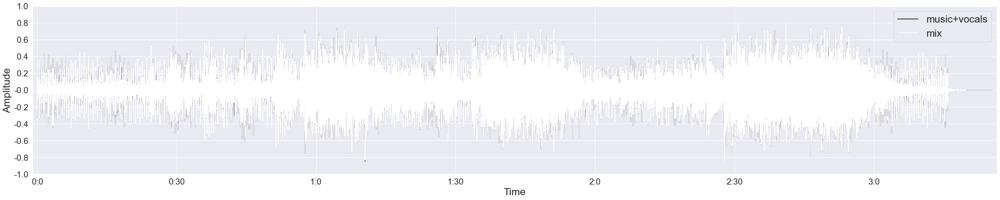

In [19]:
audio1 = AUDIO_loading (track,'bass') + AUDIO_loading (track,'drums') + AUDIO_loading (track,'other') + AUDIO_loading (track,'vocals')

audio2 = AUDIO_loading (track,'mix')

plot_audio (track, ['black', 'white'], [audio1, audio2], ['music+vocals', 'mix'], all_channels = False)

In [20]:
def duration (signal, threshold): 
    
    return (np.where (abs(signal) > threshold, 1, 0).sum()) / (60*44100)

In [24]:
# Random exemple 

threshold = 0

channel = np.random.choice (['mix', 'vocals', 'drums', 'bass', 'other'])
track = np.random.choice(np.arange(1,101))

signal = AUDIO_loading (track, channel)
mix_ = AUDIO_loading (track, 'mix')

print ('Track {} __\n'.format(track))
print ("{} duration (amplitude >{}) : {} min     mix duration (amplitude >{}) : {} min".format(channel, threshold, np.round(duration (signal, threshold), 2),
                                                                                               threshold, np.round(duration(mix_, threshold),2)))

print ("\n{} proportion vs mix : {}% ".format(channel, np.round (100 * duration (signal, threshold)/duration(mix_, threshold), 2)))

# treshold value has been assigned to 0 because the signals are not noisy
# moreover, the objective is to obtain approximate values here and a great accuracy is thus not that important

Track 85 __

other duration (amplitude >0) : 4.57 min     mix duration (amplitude >0) : 4.57 min

other proportion vs mix : 100.0% 


In [26]:
threshold = 0

data['duration'] = data['mix'].swifter.apply (lambda x: len(x)/(60*44100))
                                                                                           
for channel in ['mix', 'vocals', 'drums', 'bass', 'other', 'music']:

    data[channel] = data[channel].swifter.apply (lambda x: duration (x, threshold))

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

Pandas Apply:   0%|          | 0/100 [00:00<?, ?it/s]

In [27]:
for channel in ['mix', 'vocals', 'drums', 'bass', 'other', 'music']:
    
    data [channel + ' ratio'] = (data[channel]/data['mix'])

In [51]:
#data.to_csv ('DSD100_44100Hz_DATAVIZ.csv')
data = pd.read_csv ('DSD100_44100Hz_DATAVIZ.csv', index_col = 0)
data.round(3)

,Name,Style,mix,vocals,drums,bass,other,music,duration,mix ratio,vocals ratio,drums ratio,bass ratio,other ratio,music ratio
Index,,,,,,,,,,,,,,,
1,ANiMAL - Clinic A,UK Hip-Hop,4.249,2.584,3.817,3.960,4.248,4.249,4.344,1.0,0.608,0.898,0.932,1.000,1.000
2,ANiMAL - Rockshow,UK Hip-Hop,3.490,2.493,3.483,3.484,3.486,3.490,4.308,1.0,0.714,0.998,0.998,0.999,1.000
3,Actions - One Minute Smile,Power Pop,2.938,2.910,2.711,2.262,2.854,2.917,2.957,1.0,0.991,0.923,0.770,0.971,0.993
4,Al James - Schoolboy Facination,Bubblegum Pop,5.615,5.605,5.603,5.606,5.610,5.614,5.617,1.0,0.998,0.998,0.998,0.999,1.000
5,Angela Thomas Wade - Milk Cow Blues,Country,3.953,2.946,3.683,3.133,3.944,3.953,3.967,1.0,0.745,0.932,0.793,0.998,1.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96,Triviul - Angelsaint,Leftfield Pop/Electronica,3.065,2.810,2.985,2.956,3.056,3.065,3.200,1.0,0.917,0.974,0.964,0.997,1.000
97,Triviul feat. The Fiend - Widow,Urban R&B/Pop,4.899,2.235,4.888,2.892,4.386,4.899,5.256,1.0,0.456,0.998,0.590,0.895,1.000
98,Wall Of Death - Femme,Black Metal,3.239,2.778,3.003,2.738,3.172,3.193,3.314,1.0,0.858,0.927,0.845,0.979,0.986


In [30]:
data['vocals'].sum()/data['mix'].sum()

0.7397472226442569

# DISTRIBUTION ANALYSES

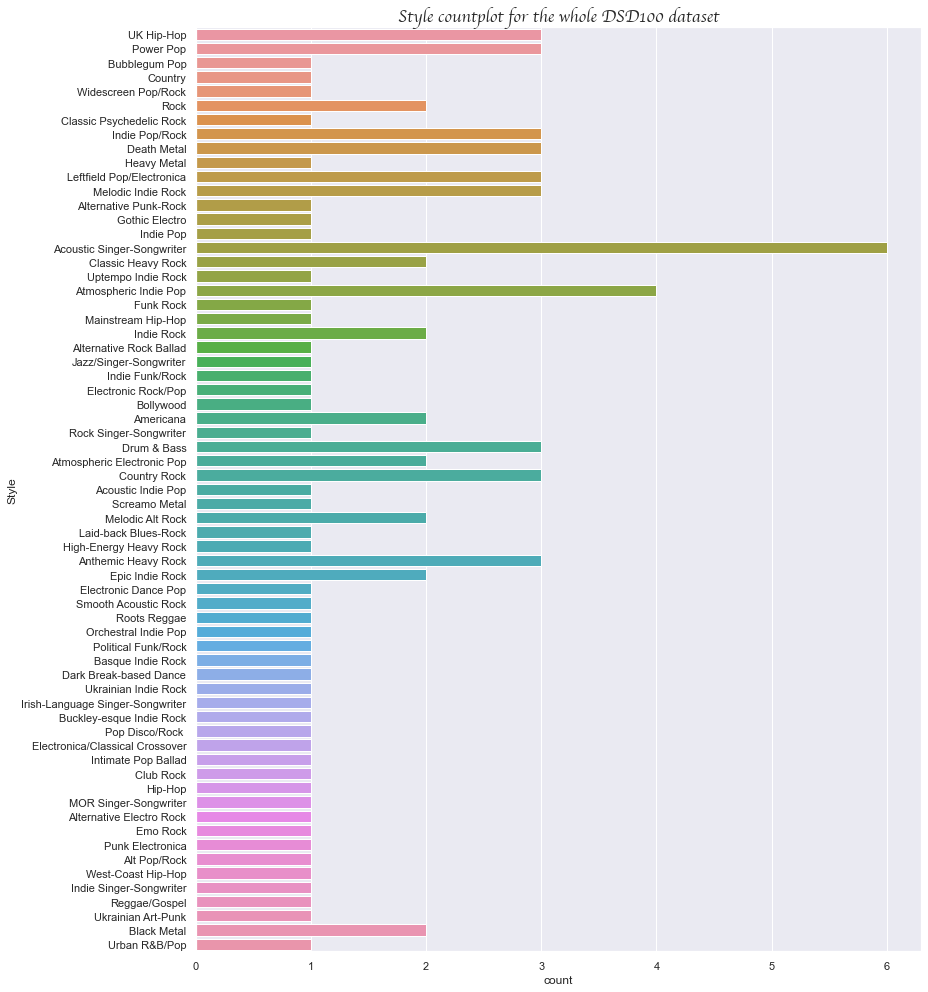

In [31]:
plt.figure (figsize = (13,17))
sns.countplot (data = data, y = 'Style')
plt.title ('Style countplot for the whole DSD100 dataset', family = 'cursive', fontsize = 17);

In [32]:
print("the number of unique 'Style' is", len(np.unique(data['Style'][~(data.Style).isna()])))

the number of unique 'Style' is 65


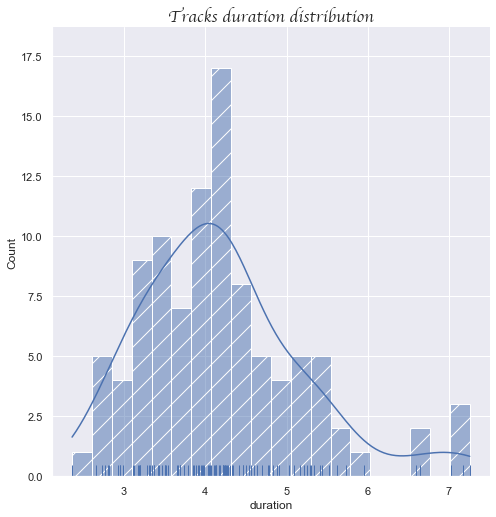

In [33]:
sns.displot (data = data, x = 'duration', kde=True, rug=True, hatch='/', bins = 20, height = 7)
plt.title ('Tracks duration distribution', family = 'cursive', fontsize = 17);

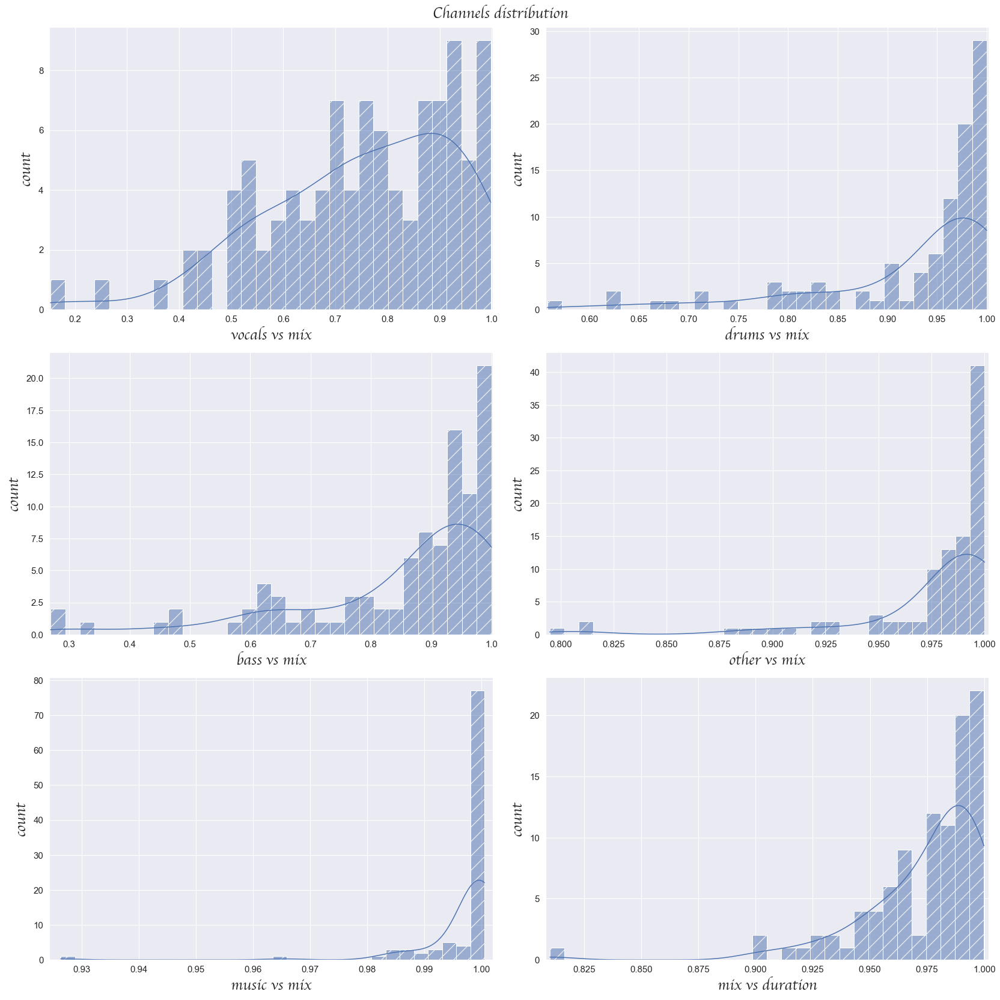

In [49]:
fig, ax = plt.subplots (3, 2, figsize = (23,23), constrained_layout=True)

sns.histplot (data['vocals ratio'], ax = ax[0,0], kde=True, hatch='/', bins = 30)
ax[0,0].set_xlabel ('vocals vs mix', family='cursive', fontsize = 25)
ax[0,0].set_ylabel ('count', family='cursive', fontsize = 25)
ax[0,0].set_xlim ([np.min (data['vocals ratio'])-0.002, 1.002])
ax[0,0].tick_params (axis = 'both', labelsize = 15)

sns.histplot (data['drums ratio'], ax = ax[0,1], kde=True, hatch='/', bins = 30)
ax[0,1].set_xlabel ('drums vs mix', family='cursive', fontsize = 25)
ax[0,1].set_ylabel ('count', family='cursive', fontsize = 25)
ax[0,1].set_xlim ([np.min (data['drums ratio'])-0.002, 1.002])
ax[0,1].tick_params (axis = 'both', labelsize = 15)

sns.histplot (data['bass ratio'], ax = ax[1,0], kde=True, hatch='/', bins = 30)
ax[1,0].set_xlabel ('bass vs mix', family='cursive', fontsize = 25)
ax[1,0].set_ylabel ('count', family='cursive', fontsize = 25)
ax[1,0].set_xlim ([np.min (data['bass ratio'])-0.002, 1.002])
ax[1,0].tick_params (axis = 'both', labelsize = 15)

sns.histplot (data['other ratio'], ax = ax[1,1], kde=True, hatch='/', bins = 30)
ax[1,1].set_xlabel('other vs mix', family='cursive', fontsize = 25)
ax[1,1].set_ylabel('count', family='cursive', fontsize = 25)
ax[1,1].set_xlim ([np.min (data['other ratio'])-0.002, 1.002])
ax[1,1].tick_params (axis = 'both', labelsize = 15)

sns.histplot (data['music ratio'], ax = ax[2,0], kde=True, hatch='/', bins = 30)
ax[2,0].set_xlabel ('music vs mix', family='cursive', fontsize = 25)
ax[2,0].set_ylabel ('count', family='cursive', fontsize = 25)
ax[2,0].set_xlim ([np.min (data['music ratio'])-0.002, 1.002])
ax[2,0].tick_params (axis = 'both', labelsize = 15)

sns.histplot (data['mix']/data['duration'], ax = ax[2,1], kde=True, hatch='/', bins = 30)
ax[2,1].set_xlabel ('mix vs duration', family='cursive', fontsize = 25)
ax[2,1].set_ylabel ('count', family='cursive', fontsize = 25)
ax[2,1].set_xlim ([np.min (data['mix']/data['duration'])-0.002, 1.002])
ax[2,1].tick_params (axis = 'both', labelsize = 15)

fig.suptitle ('Channels distribution', family='cursive', fontsize = 25)
plt.show();

In [50]:
data[data.columns[1:]].describe().round(3)

,mix,vocals,drums,bass,other,music,duration,mix ratio,vocals ratio,drums ratio,bass ratio,other ratio,music ratio
count,100.000,100.000,100.000,100.000,100.000,100.000,100.000,100.0,100.000,100.000,100.000,100.000,100.000
mean,4.088,3.024,3.778,3.460,3.986,4.076,4.198,1.0,0.752,0.925,0.851,0.975,0.997
std,0.979,0.901,0.997,1.028,0.965,0.981,0.999,0.0,0.180,0.097,0.168,0.040,0.009
min,2.355,0.766,2.124,0.875,2.338,2.355,2.361,1.0,0.153,0.558,0.269,0.795,0.926
25%,3.419,2.396,3.073,2.745,3.334,3.380,3.492,1.0,0.631,0.899,0.792,0.977,0.999
50%,3.956,2.912,3.673,3.514,3.836,3.954,4.116,1.0,0.778,0.967,0.918,0.989,1.000
75%,4.574,3.580,4.268,3.977,4.422,4.574,4.648,1.0,0.895,0.988,0.965,0.999,1.000
max,7.107,5.605,6.932,6.547,7.106,7.107,7.254,1.0,0.998,1.000,1.000,1.000,1.001
